In [ ]:
!pip install bokeh
!pip install statsmodels
!pip install shap
!pip install --no-binary lightgbm --config-settings=cmake.define.USE_OPENMP=OFF --config-settings=cmake.define.USE_GPU=ON 'lightgbm>=4.0.0'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.5/540.5 kB 5.3 MB/s eta 0:00:00


In [ ]:
!pip install cudf

In [ ]:
import cudf  # this should work without any errors
%load_ext cudf.pandas

In [ ]:
import locale
print(locale.getpreferredencoding())

UTF-8


In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [ ]:
!nvidia-smi  # this should display information about available GPUs

/bin/bash: line 1: nvidia-smi: command not found


In [ ]:
import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    # Base
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt
    from matplotlib import dates
    import seaborn as sns
    import os

    # Plot using bokeh
    import bokeh
    from bokeh.models import CustomJS, ColumnDataSource, Slider, Label, Div, HoverTool, Band, Span, BoxAnnotation
    from bokeh.plotting import figure
    from bokeh.palettes import Spectral11
    import ipywidgets as widgets
    from IPython.display import display
    from typing import Union, Dict, List, Callable

    #StatsModel
    import statsmodels
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    from statsmodels.nonparametric.smoothers_lowess import lowess
    from statsmodels.tsa.seasonal import seasonal_decompose, STL
    from statsmodels.tsa.api import SimpleExpSmoothing


    # Model
    import tensorflow as tf
    from tensorflow import keras
    import lightgbm as lgb
    import shap
    from sklearn.model_selection import TimeSeriesSplit, GridSearchCV, RandomizedSearchCV
    from sklearn.metrics import make_scorer

# Configuration
#import warnings
#warnings.filterwarnings('ignore')
#pd.set_option('display.max_columns', None)
#warnings.simplefilter('ignore')
#pd.options.mode.chained_assignment = None # to supress dataframe warning

In [ ]:
train = pd.read_csv("train.csv", parse_dates=["date"])
test = pd.read_csv("test.csv", parse_dates=["date"])

In [ ]:
print("###################### Train ######################")
train.info()
print("\n###################### Test ######################")
test.info()

###################### Train ######################
<class 'cudf.core.dataframe.DataFrame'>
RangeIndex: 913000 entries, 0 to 912999
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype
---  ------  --------------   -----
 0   date    913000 non-null  datetime64[ns]
 1   store   913000 non-null  int64
 2   item    913000 non-null  int64
 3   sales   913000 non-null  int64
dtypes: datetime64[ns](1), int64(3)
memory usage: 27.9 MB

###################### Test ######################
<class 'cudf.core.dataframe.DataFrame'>
RangeIndex: 45000 entries, 0 to 44999
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   id      45000 non-null  int64
 1   date    45000 non-null  datetime64[ns]
 2   store   45000 non-null  int64
 3   item    45000 non-null  int64
dtypes: datetime64[ns](1), int64(3)
memory usage: 1.4 MB


In [ ]:
## randomly assign promo flags
def add_flags(df):
    np.random.seed(42)
    df['Promo'] = np.random.randint(low = 0,high = 2,size = df.shape[0])
    df['SchoolHoliday'] = np.random.randint(low = 0,high = 2,size = df.shape[0])
    return df

train = add_flags(train)
test = add_flags(test)

In [ ]:
train.head()

,date,store,item,sales,Promo,SchoolHoliday
0,2013-01-01,1,1,13,0,0
1,2013-01-02,1,1,11,1,1
2,2013-01-03,1,1,14,0,0
3,2013-01-04,1,1,13,0,0
4,2013-01-05,1,1,10,0,0


In [ ]:
train["date"].nunique()

1826

In [ ]:
train.describe()

,date,store,item,sales,Promo,SchoolHoliday
count,913000,913000.000000,913000.000000,913000.000000,913000.000000,913000.000000
mean,2015-07-02 11:59:59.999999744,5.500000,25.500000,52.250287,0.499719,0.499938
min,2013-01-01 00:00:00,1.000000,1.000000,0.000000,0.000000,0.000000
25%,2014-04-02 00:00:00,3.000000,13.000000,30.000000,0.000000,0.000000
50%,2015-07-02 12:00:00,5.500000,25.500000,47.000000,0.000000,0.000000
75%,2016-10-01 00:00:00,8.000000,38.000000,70.000000,1.000000,1.000000
max,2017-12-31 00:00:00,10.000000,50.000000,231.000000,1.000000,1.000000
std,None,2.872283,14.430878,28.801144,0.500000,0.500000


# Exploratory Data Analysis
Let's begin some exploratory data analysis! We'll start by checking out missing data!

In [ ]:
train.isnull().sum()

date             0
store            0
item             0
sales            0
Promo            0
SchoolHoliday    0
dtype: int64

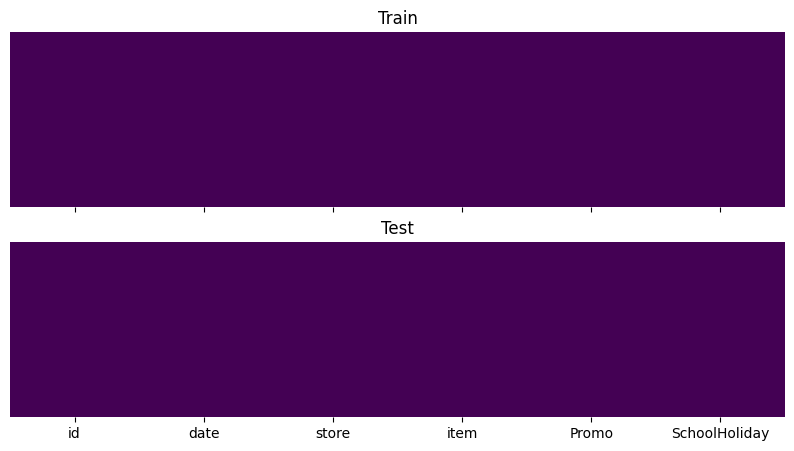

In [ ]:
fig, axes = plt.subplots(2,1, sharex=True, figsize=(10,5))
sns.heatmap(train.isnull(), yticklabels=False, cbar=False, cmap='viridis', ax=axes[0])
axes[0].set_title("Train")

sns.heatmap(test.isnull(), yticklabels=False, cbar=False, cmap='viridis', ax=axes[1])
axes[1].set_title("Test")

plt.show()

In [ ]:
print("Earliest date in dataset: " + str(min(train["date"]))[0:10])
print("Latest date in dataset: " + str(max(train["date"]))[0:10])
print("")
print("Earliest date in test: " + str(min(test["date"]))[0:10])
print("Latest date in test :" + str(max(test["date"]))[0:10])

Earliest date in dataset: 2013-01-01
Latest date in dataset: 2017-12-31

Earliest date in test: 2018-01-01
Latest date in test :2018-03-31


In [ ]:
#val = train.query("date >= '2017-10-01'")
#train = train[(train["date"] >= "2015-01-01") & (train["date"] <= "2017-09-30")]
#df = pd.concat([train, val, test], sort=False)

In [ ]:
train = train.query("date >= '2015-01-01'")
#df = pd.concat([train, test], sort=False)

In [ ]:
# Sorting the data by store, item and date

#train.sort_values(by=["store","item","date"], axis=0, inplace=True)
#val.sort_values(by=["store","item","date"], axis=0, inplace=True)
#test.sort_values(by=["store","item","date"], axis=0, inplace=True)
#df.sort_values(by=["store","item","date"], axis=0, inplace=True)
train.head()

,date,store,item,sales,Promo,SchoolHoliday
730,2015-01-01,1,1,11,0,0
731,2015-01-02,1,1,19,0,1
732,2015-01-03,1,1,16,0,1
733,2015-01-04,1,1,14,1,1
734,2015-01-05,1,1,14,1,1


In [ ]:
print("Months in train set: "+ str(round((train["date"].nunique()/365)*12)))
#print("Months in validation set: "+ str(round((val["date"].nunique()/365)*12)))
print("Months in test set: "+ str(round((test["date"].nunique()/365)*12)))
#print("Months in overall dataset: "+ str(round((df["date"].nunique()/365)*12)))

Months in train set: 36
Months in test set: 3


In [ ]:
#df.drop("id",axis=1, inplace=True)
#df

In [ ]:
# How many stores and items are there?
train["store"].nunique(), test["store"].nunique(), train["item"].nunique(), test["item"].nunique()

(10, 10, 50, 50)

In [ ]:
# How many items are in the store?
train.groupby(["store"])["item"].nunique()

store
1     50
2     50
3     50
4     50
5     50
6     50
7     50
8     50
9     50
10    50
Name: item, dtype: int32

In [ ]:
# Summary Stats for each store
train.groupby(["store"]).agg({"sales": ["count","sum", "mean", "median", "std", "min", "max"]})

sales                                               
       count      sum       mean median        std min  max
store                                                      
1      54800  2770977  50.565274   47.0  25.090488   3  155
2      54800  3928093  71.680529   67.0  35.136805   6  231
3      54800  3490688  63.698686   60.0  31.341356   6  196
4      54800  3218375  58.729471   55.0  29.011546   5  186
5      54800  2331634  42.548066   40.0  21.268775   2  130
6      54800  2328083  42.483266   40.0  21.253564   2  134
7      54800  2131808  38.901606   36.0  19.533932   1  122
8      54800  3759617  68.606150   64.0  33.723252   6  204
9      54800  3228409  58.912573   55.0  29.104072   4  195
10     54800  3440103  62.775602   59.0  30.885428   5  187

In [ ]:
# Summary Stats for each item
train.groupby(["item"]).agg({"sales": ["count","sum", "mean", "median", "std", "min", "max"]})

sales                                               
      count      sum       mean median        std min  max
item                                                      
1     10960   257884  23.529562   23.0   8.707086   1   59
2     10960   686659  62.651369   61.0  20.628877  15  150
3     10960   429771  39.212682   38.0  13.526118   8  104
4     10960   257568  23.500730   23.0   8.604330   2   66
5     10960   215740  19.684307   19.0   7.455227   2   50
6     10960   685540  62.549270   60.0  20.631289  14  148
7     10960   685995  62.590785   60.0  20.603655  15  141
8     10960   902371  82.333120   80.0  26.723440  20  181
9     10960   602511  54.973631   53.0  18.239010  10  134
10    10960   859145  78.389142   76.0  25.343342  19  175
11    10960   817133  74.555931   72.0  24.293810  14  170
12    10960   815994  74.452007   72.0  24.326911  19  170
13    10960   988566  90.197628   87.0  28.943677  23  210
14    10960   688361  62.806661   61.0  20.530147  14  152
15    10960  1031815  94.143704   91.0  30.207272  23  231
16    10960   300840  27.448905   27.0   9.835537   3   70
17    10960   386325  35.248631   34.0  12.195878   5   83
18    10960   987723  90.120712   87.0  29.153187  21  208
19    10960   473107  43.166697   42.0  14.664918   7   99
20    10960   557410  50.858577   49.0  16.883840  12  127
21    10960   472258  43.089234   42.0  14.690929   7  109
22    10960   943214  86.059672   83.0  27.734857  22  214
23    10960   343937  31.381113   30.0  11.105764   6   81
24    10960   774253  70.643522   68.0  23.015002  16  156
25    10960   946080  86.321168   83.0  27.797765  23  193
26    10960   558469  50.955201   49.0  17.097139  10  119
27    10960   258395  23.576186   23.0   8.676599   2   59
28    10960  1029550  93.937044   91.0  30.205777  23  206
29    10960   816247  74.475091   72.0  24.206184  18  173
30    10960   473054  43.161861   41.0  14.740202   7  115
31    10960   687392  62.718248   61.0  20.473641  10  159
32    10960   515541  47.038412   45.0  15.959076   9  119
33    10960   815302  74.388869   72.0  24.293767  18  169
34    10960   301981  27.553011   26.0   9.823830   3   79
35    10960   771395  70.382755   68.0  22.988219  17  168
36    10960   903185  82.407391   79.5  26.596425  22  188
37    10960   343080  31.302920   30.0  11.062541   4   74
38    10960   943869  86.119434   83.0  27.765105  21  188
39    10960   514952  46.984672   45.0  15.829855   8  112
40    10960   342978  31.293613   30.0  11.123317   3   74
41    10960   258295  23.567062   23.0   8.659009   3   60
42    10960   429869  39.221624   38.0  13.528692   7   96
43    10960   601437  54.875639   53.0  18.164449  12  126
44    10960   344220  31.406934   30.0  11.060201   4   78
45    10960   945367  86.256113   84.0  27.883202  22  205
46    10960   687033  62.685493   61.0  20.708825  14  150
47    10960   258089  23.548266   23.0   8.614899   3   61
48    10960   602071  54.933485   53.0  18.327133  11  130
49    10960   344030  31.389599   30.0  11.128858   4   77
50    10960   771786  70.418431   68.0  22.964612  16  164

In [ ]:
train_copy = train.copy()

## Histogram of Store Sales

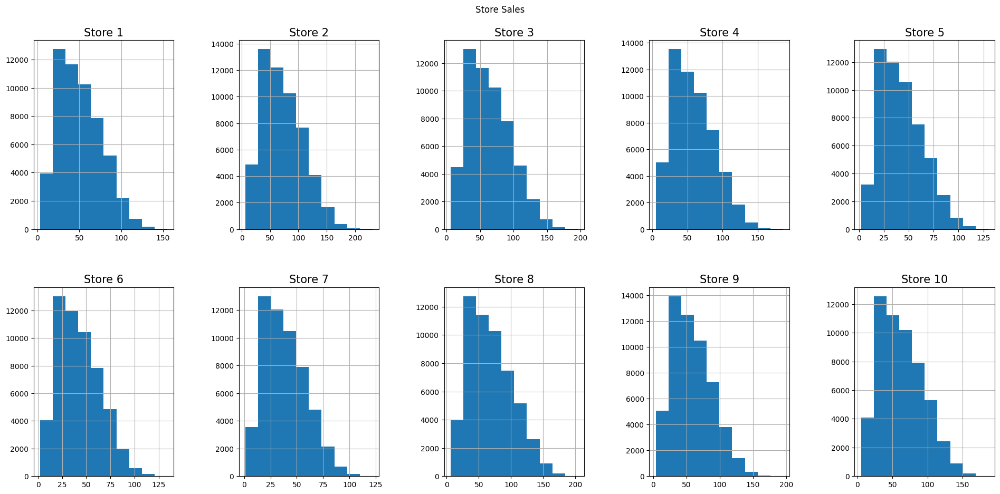

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(20, 10))
for i in range(1,11):
    if i < 6:
        train_copy[train_copy["store"] == i]["sales"].hist(ax=axes[0, i-1])
        axes[0,i-1].set_title("Store " + str(i), fontsize = 15)

    else:
        train_copy[train_copy["store"] == i]["sales"].hist(ax=axes[1, i - 6])
        axes[1,i-6].set_title("Store " + str(i), fontsize = 15)
plt.tight_layout(pad=4.5)
plt.suptitle("Store Sales");

## Sales Distribution for each item in the each store

In [ ]:
def store_item_plot(store):
    store = store
    sub = train_copy[train_copy["store"] == store].set_index("date")

    fig, axes = plt.subplots(10, 5, figsize=(20, 35))
    for i in range(1,51):
        if i < 6:
            sub[sub["item"] == i].sales.plot(ax=axes[0, i-1], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 6 and i<11:
            sub[sub["item"] == i].sales.plot(ax=axes[1, i - 6], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 11 and i<16:
            sub[sub["item"] == i].sales.plot(ax=axes[2, i - 11], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 16 and i<21:
            sub[sub["item"] == i].sales.plot(ax=axes[3, i - 16], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 21 and i<26:
            sub[sub["item"] == i].sales.plot(ax=axes[4, i - 21], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 26 and i<31:
            sub[sub["item"] == i].sales.plot(ax=axes[5, i - 26], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 31 and i<36:
            sub[sub["item"] == i].sales.plot(ax=axes[6, i - 31], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 36 and i<41:
            sub[sub["item"] == i].sales.plot(ax=axes[7, i - 36], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 41 and i<46:
            sub[sub["item"] == i].sales.plot(ax=axes[8, i - 41], legend=True, label = "Item "+str(i)+" Sales")
        if i >= 46 and i<51:
            sub[sub["item"] == i].sales.plot(ax=axes[9, i - 46], legend=True, label = "Item "+str(i)+" Sales")
    plt.tight_layout(pad=8)
    plt.suptitle("Store "+ str(store) + " Item Sales");

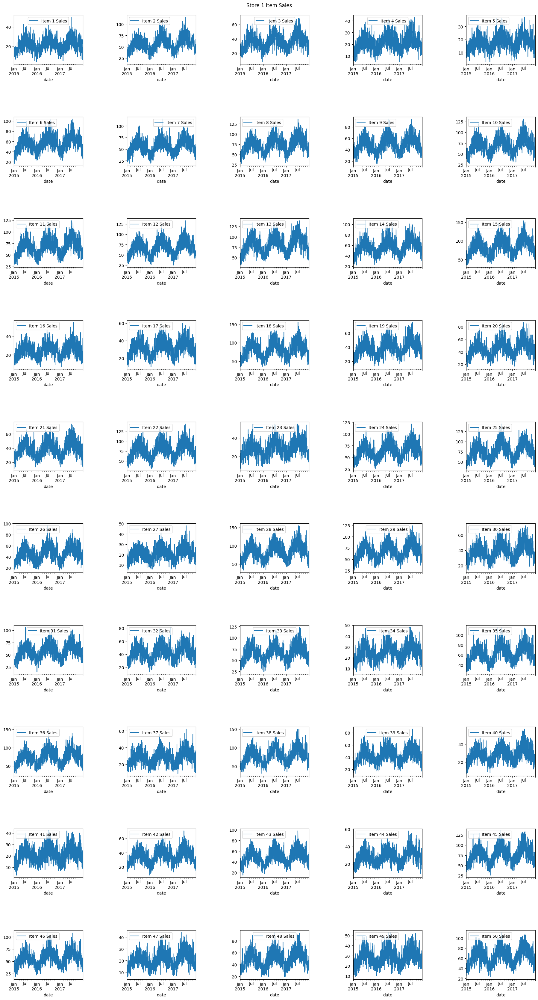

In [ ]:
# Sale distribution of store 1
store_item_plot(store=1)

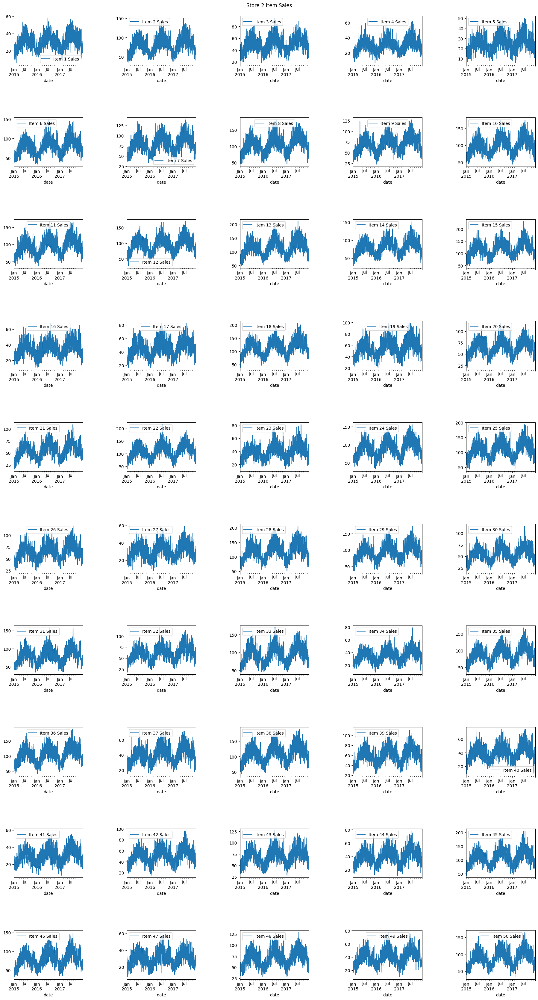

In [ ]:
# Sale distribution of store with the highest total sales
store_item_plot(store=2)

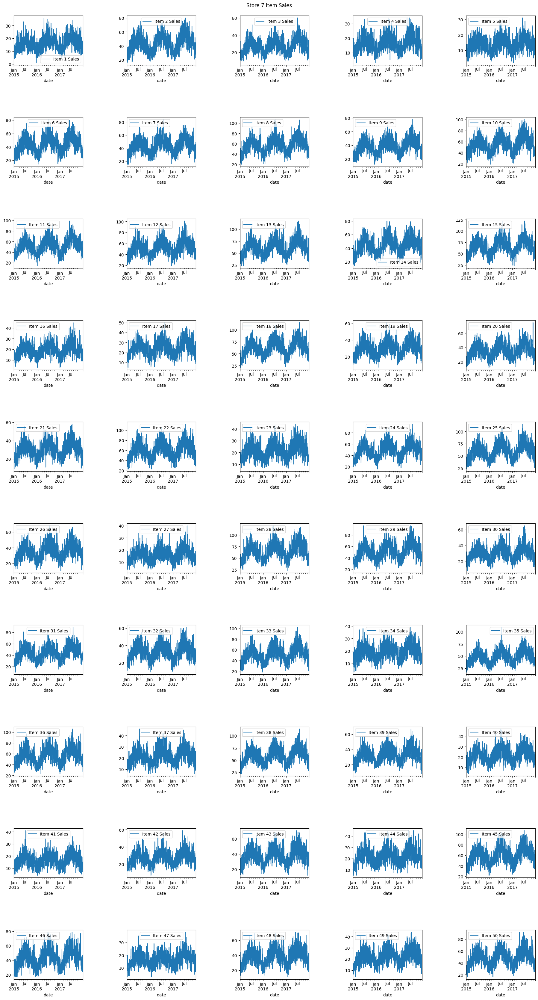

In [ ]:
# Sale distribution of store with the lowest total sales
store_item_plot(store=7)

Output()

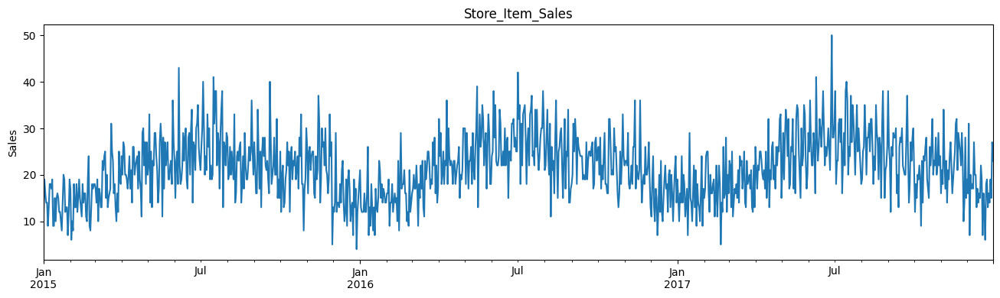

In [ ]:
def sales_plot_bokeh(i_num, s_num):

    p1 = train_copy.query("store == @s_num & item == @i_num").set_index("date")["sales"].plot(
        label = "Store " + str(s_num)+ "Item "+str(i_num)+" Sales",figsize=(16,4))
    p1.set(ylabel="Sales")
    p1.set(xlabel="")
    p1.set_title("Store_Item_Sales")


store_slider = widgets.IntSlider(min=1, max=10, continuous_update=False, description="Store",
                             layout={"width": "2.8in", "height": "1in"})

item_slider = widgets.IntSlider(min=1, max=50, continuous_update=False, description="Item",
                             layout={"width": "2.8in", "height": "1in"})


ui = widgets.HBox([store_slider, item_slider],
                  layout={"min_width": "1in", "max_width": "20in"})

out = widgets.interactive_output(sales_plot_bokeh, {"s_num": store_slider, "i_num": item_slider})
display(ui, out)

## Correlation between total sales of stores

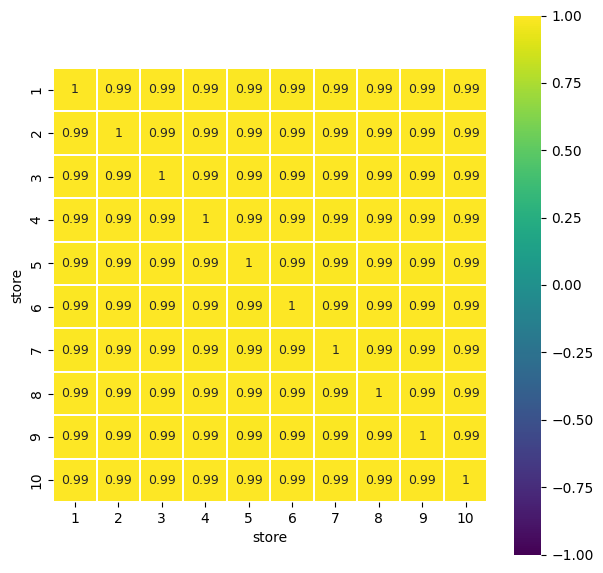

In [ ]:
storesales = train_copy.groupby(["date", "store"]).sales.sum().reset_index().set_index("date")
corr =  pd.pivot_table(storesales, values = "sales", columns="store", index="date").corr(method = "spearman")
plt.figure(figsize = (7,7))
sns.heatmap(corr[(corr >= 0.5) | (corr <= -0.5)],
            cmap="viridis", vmax=1.0, vmin=-1.0, linewidths=0.1,
            annot=True, annot_kws={"size": 9}, square=True);

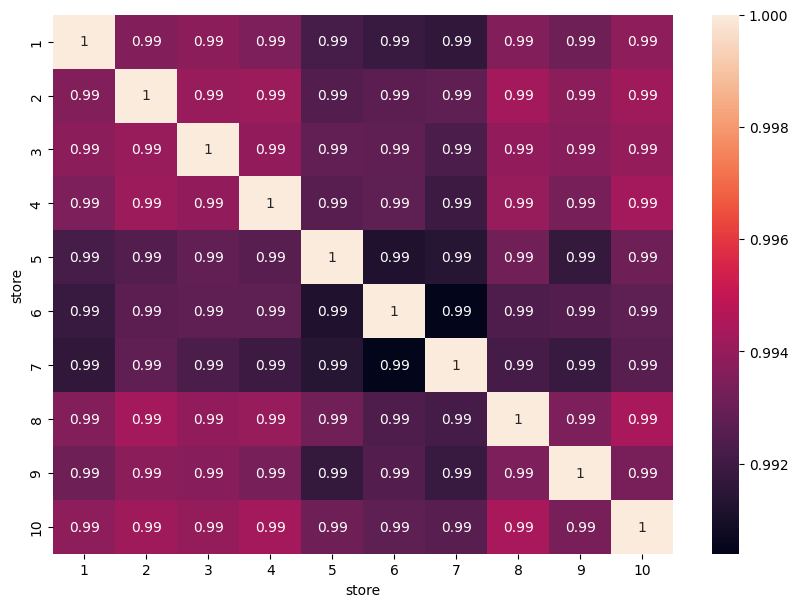

In [ ]:
plt.figure(figsize = (10,7))
sns.heatmap(corr,annot=True);

## Daily Sales

In [ ]:
store_daily_sales = train_copy.groupby(["store", "date"], as_index=False)["sales"].sum()
item_daily_sales = train_copy.groupby(["item", "date"], as_index=False)["sales"].sum()

In [ ]:
store_daily_sales.head()

,store,date,sales
0,1,2015-01-01,1508
1,1,2015-01-02,1681
2,1,2015-01-03,1741
3,1,2015-01-04,1932
4,1,2015-01-05,1337


### Daily Sales by Store

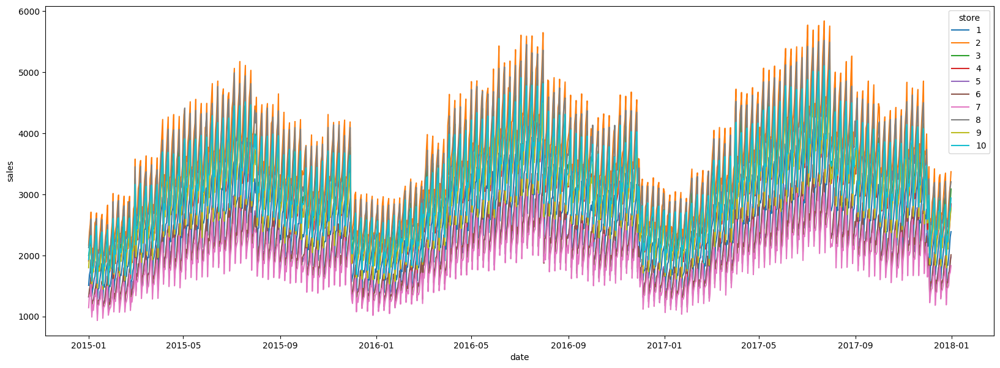

In [ ]:
plt.figure(figsize = (20,7))
sns.lineplot(data=store_daily_sales, x="date", y="sales", hue="store", palette="tab10");

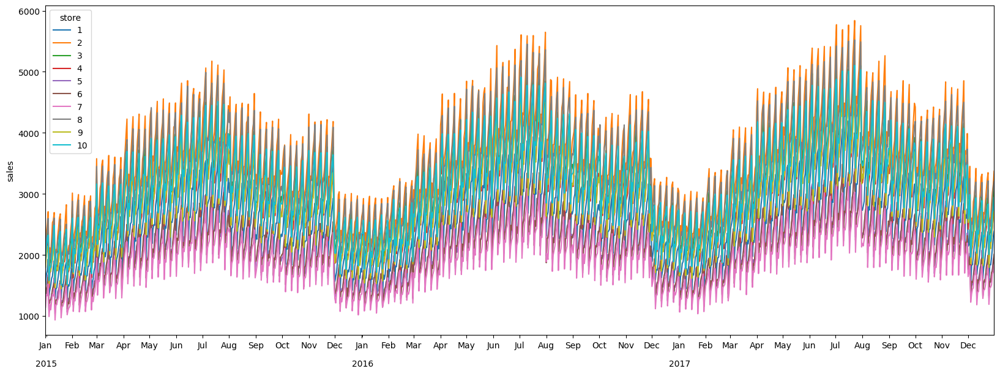

In [ ]:
plt.figure(figsize = (20,7))

ax = sns.lineplot(data=store_daily_sales, x="date", y="sales", hue="store", palette="tab10");

ax.set(ylabel="sales")
ax.set(xlabel="")
ax.set_xlim(store_daily_sales["date"].min(), store_daily_sales["date"].max())

ax.xaxis.set_major_locator(dates.MonthLocator())
ax.xaxis.set_major_formatter(dates.DateFormatter('%b'))

ax.xaxis.set_minor_locator(dates.YearLocator(1, month=1, day=2))
ax.xaxis.set_minor_formatter(dates.DateFormatter('\n\n%Y'))
plt.show()

### Daily Sales by Item

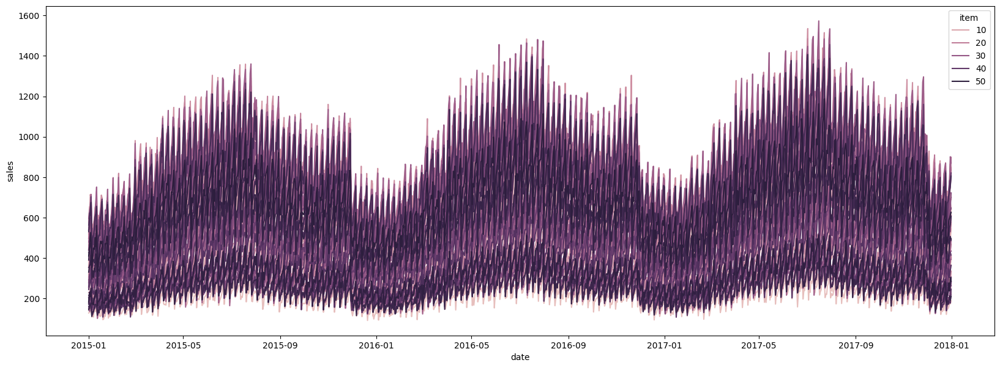

In [ ]:
plt.figure(figsize = (20,7))
sns.lineplot(data=item_daily_sales, x="date", y="sales", hue="item");

In [ ]:
train_copy["month"] = train["date"].dt.month

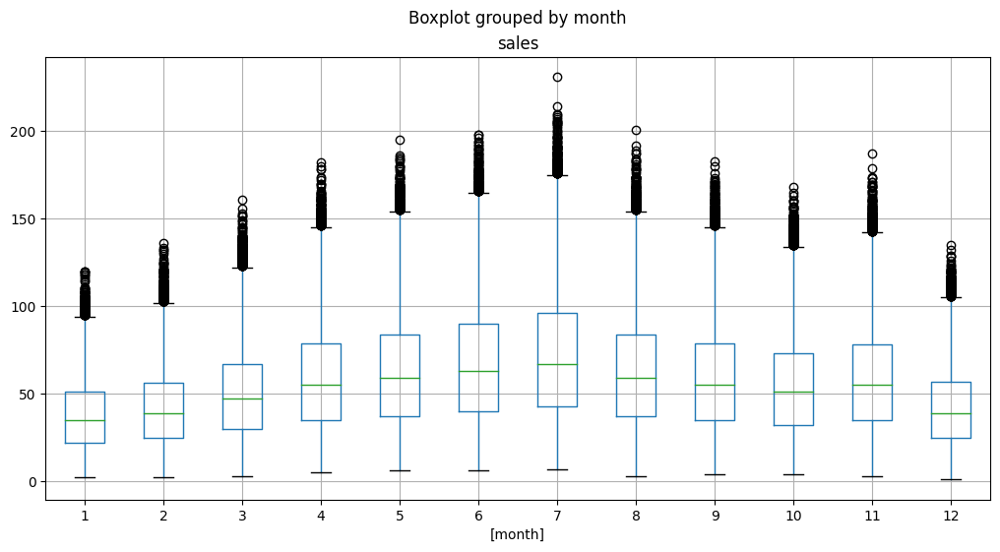

In [ ]:
train_copy[["sales","month"]].boxplot(by="month", figsize=(12,6));

# Time Series Decomposition

<Figure size 640x480 with 0 Axes>

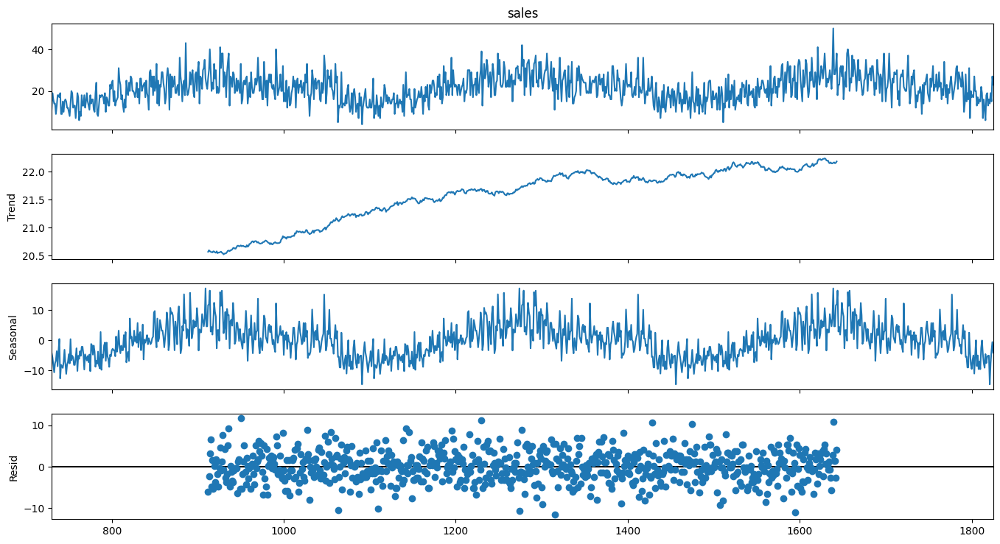

In [ ]:
# Trend and Seasonality of Store 1, Item 1
train_copy_1_1 = train_copy.query("store == 1 & item == 1")
decomp = seasonal_decompose(train_copy_1_1["sales"], model = "additive", period = 365)

fig = plt.figure()
fig = decomp.plot();
fig.set_size_inches(15,8)

In [ ]:
def seasonal_dec(store, item, period = 365):

    for i in range(1,item):

        df_se_decomp = train_copy.query("store == @store & item == @item").set_index("date")
        decomp = seasonal_decompose(df_se_decomp["sales"], model = "multiplicative", period = 365)

        fig, axes = plt.subplots(1,2, sharex=True, figsize=(18,5))
        decomp.trend.plot(ax=axes[0])
        axes[0].set_title("Trend")
        axes[0].set(xlabel="")

        decomp.seasonal.plot(ax=axes[1])
        axes[1].set_title("Seasonality")
        axes[1].set(xlabel="")

        plt.suptitle("Store "+ str(store) + " Item "+ str(i));
        plt.show()

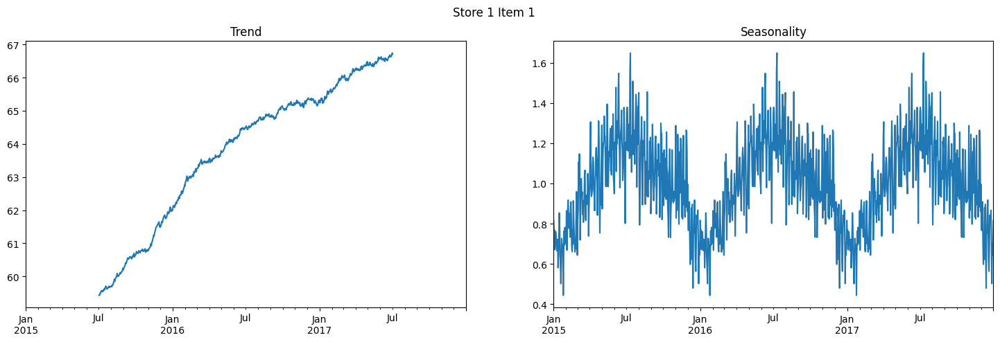

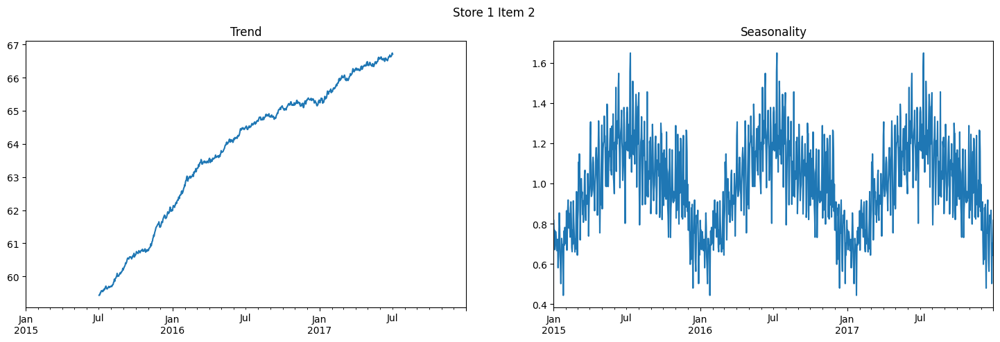

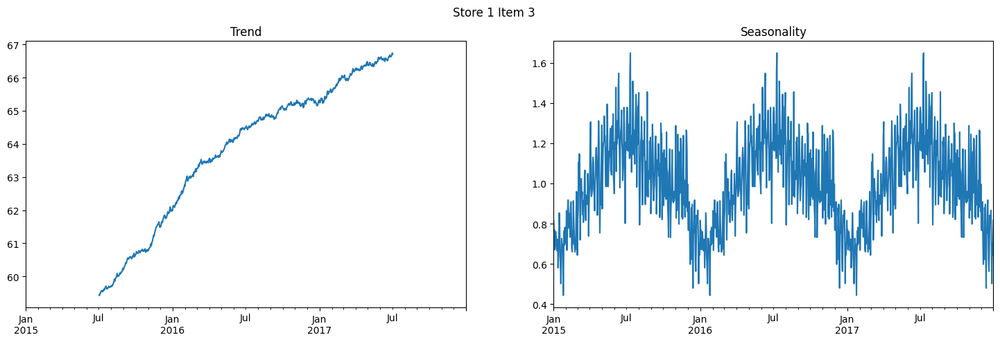

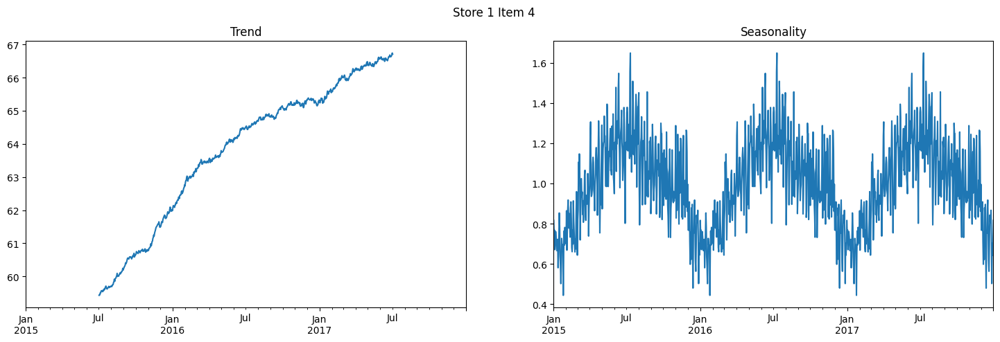

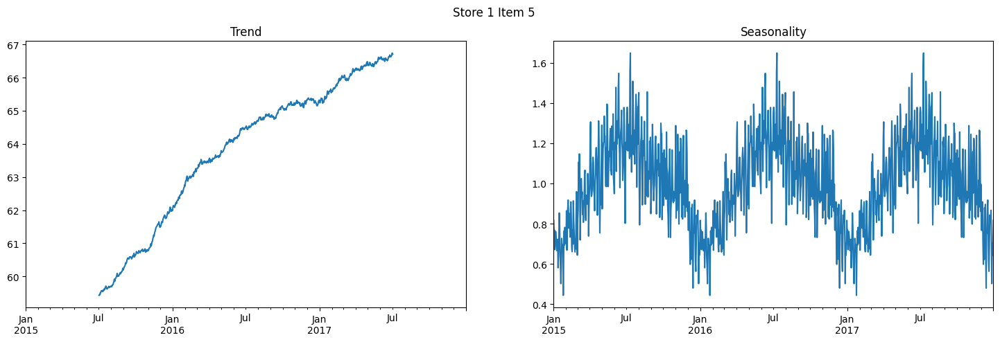

...

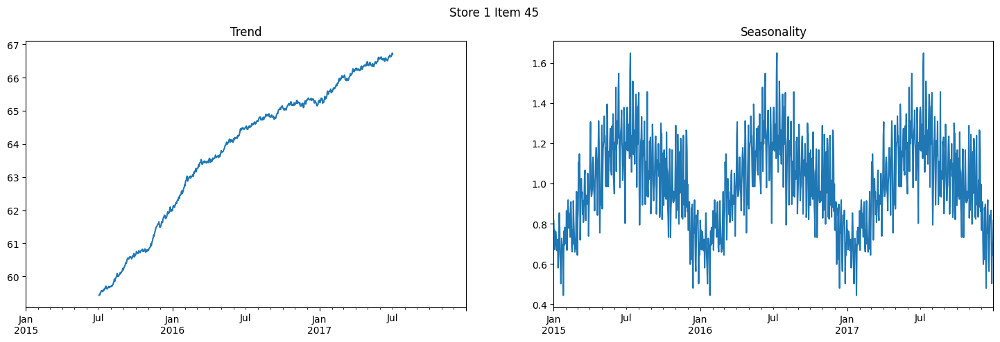

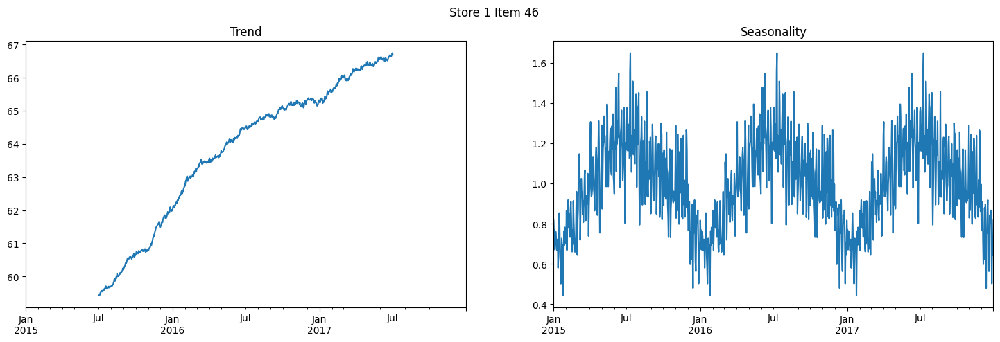

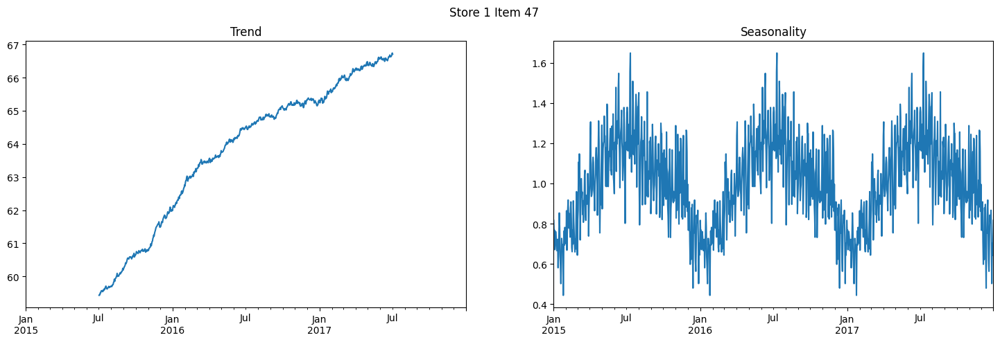

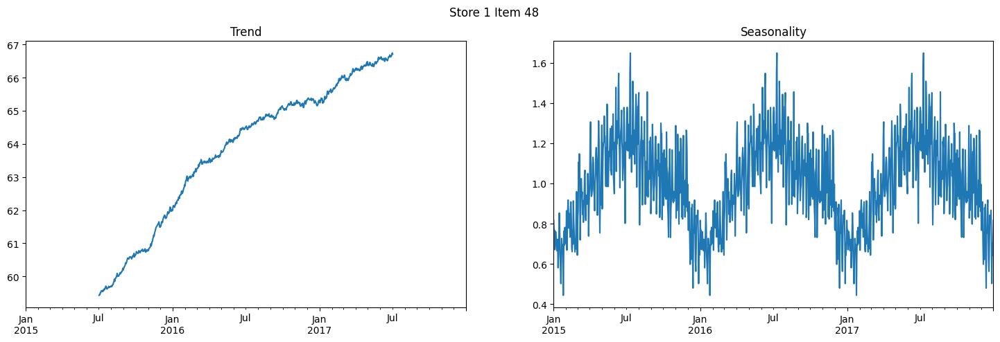

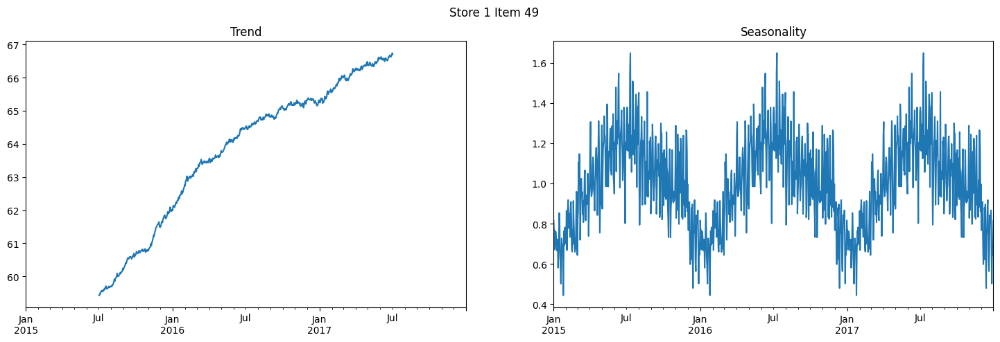

In [ ]:
# Trend and Seasonality of Store 1
seasonal_dec(store=1, item=max(train["item"]))

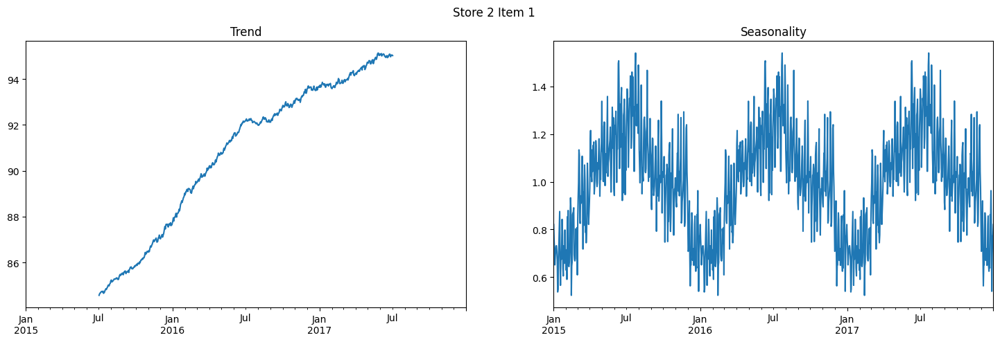

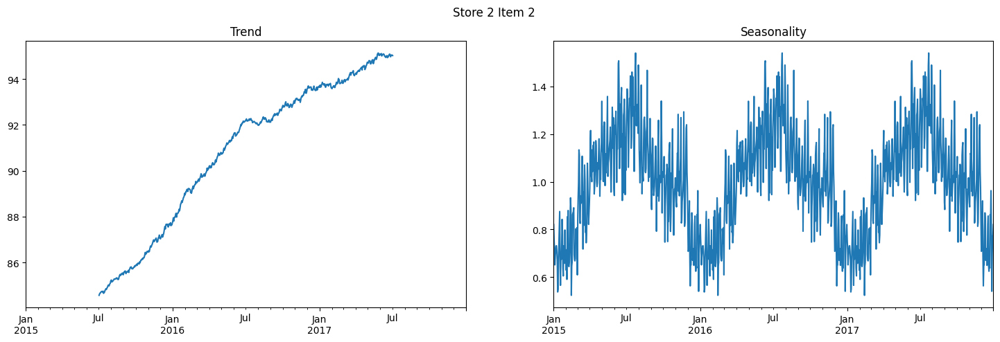

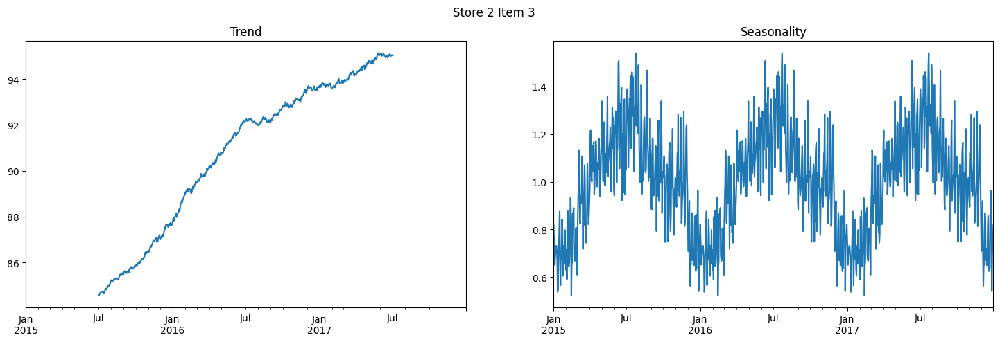

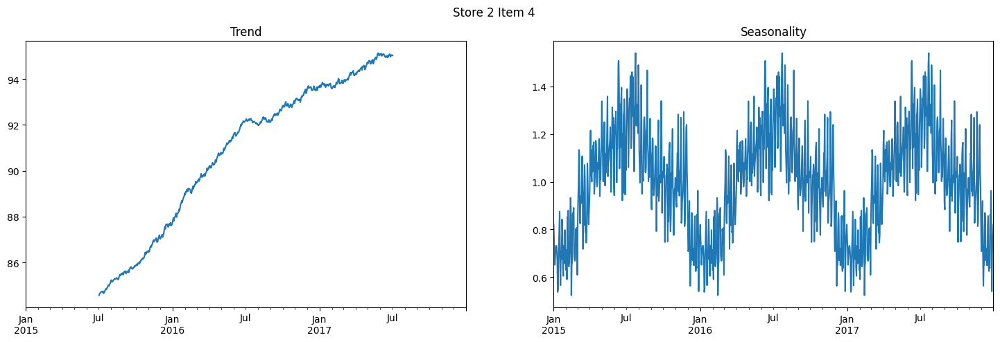

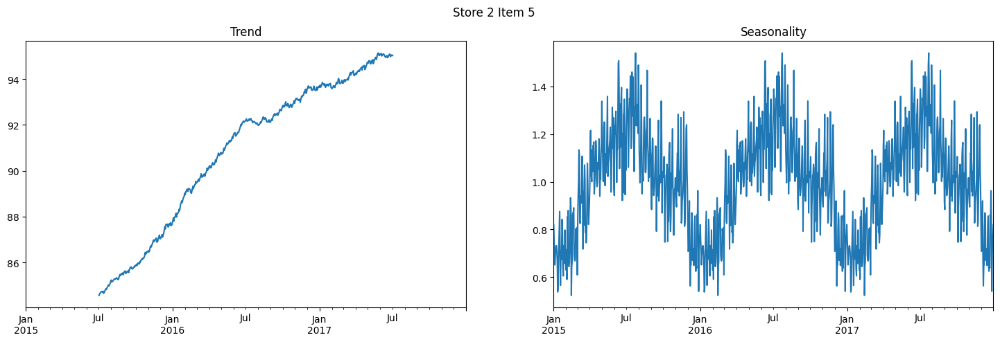

...

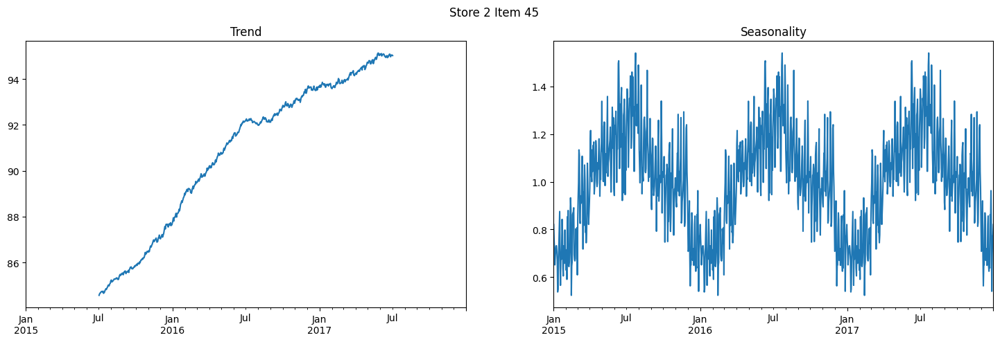

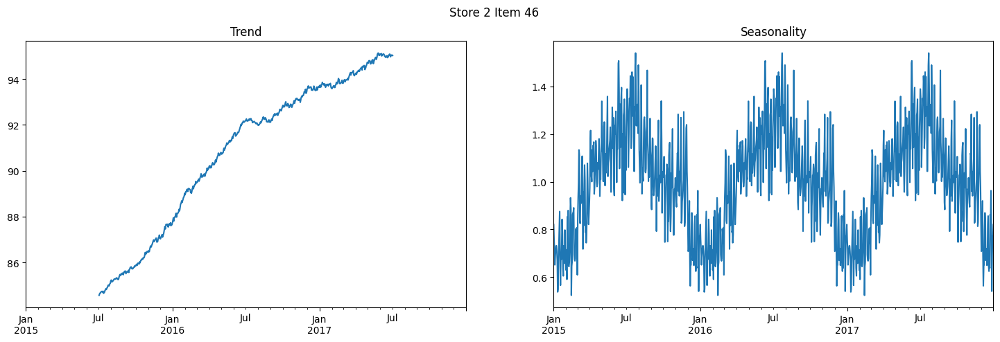

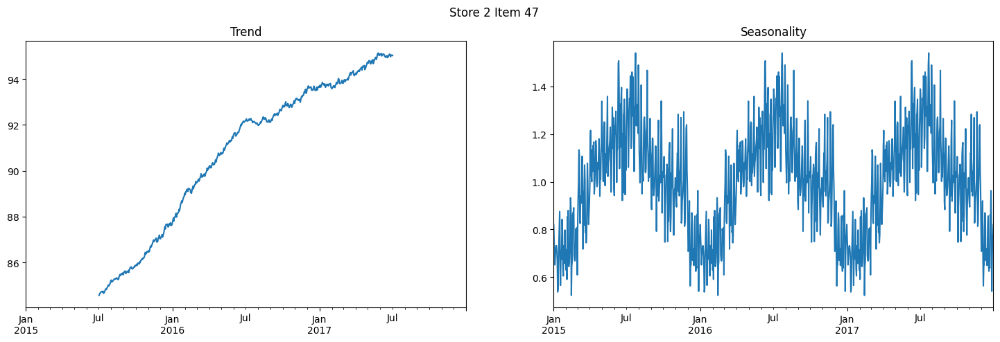

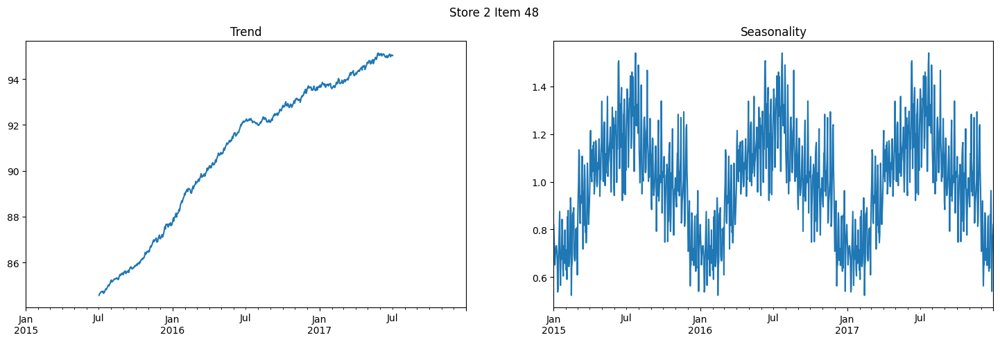

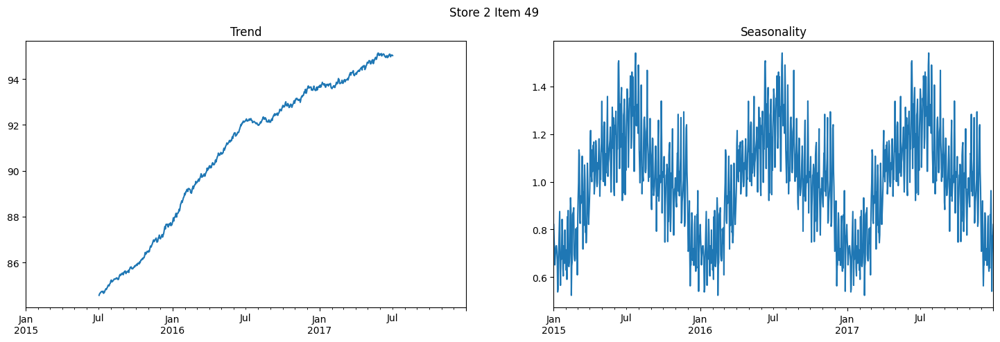

In [ ]:
# Trend and Seasonality of store with the highest total sales
seasonal_dec(store=2, item=max(train["item"]))

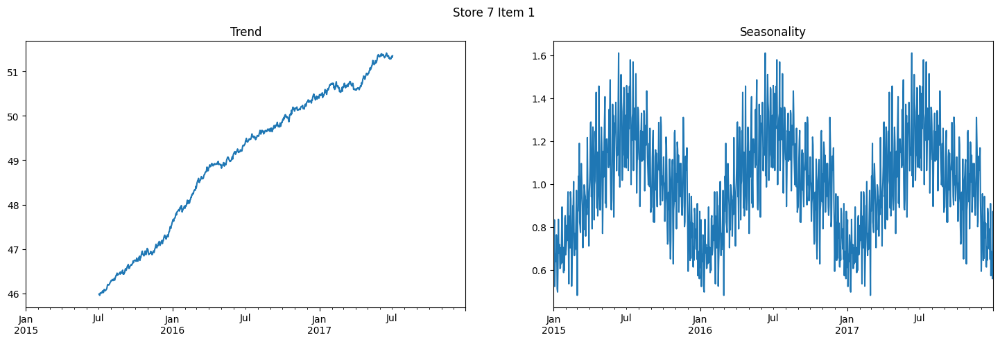

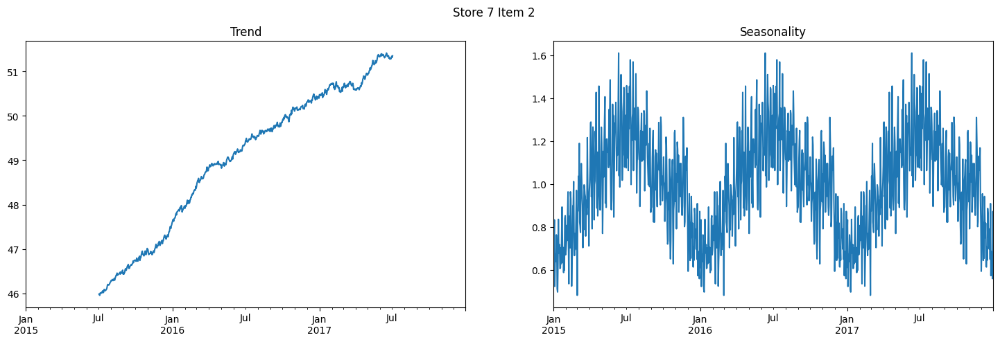

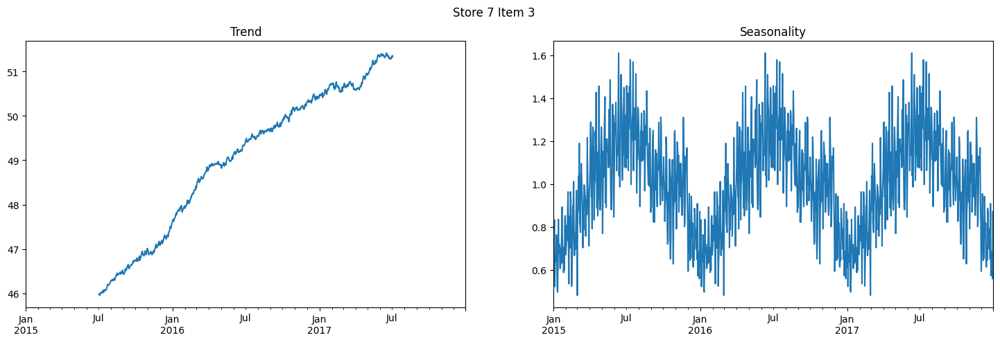

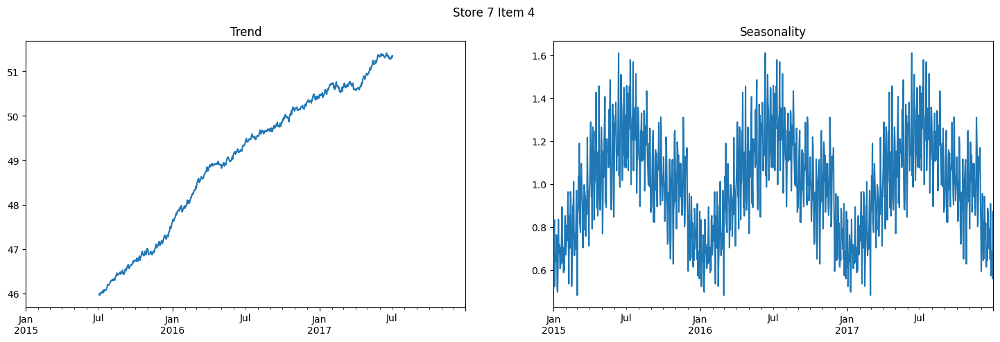

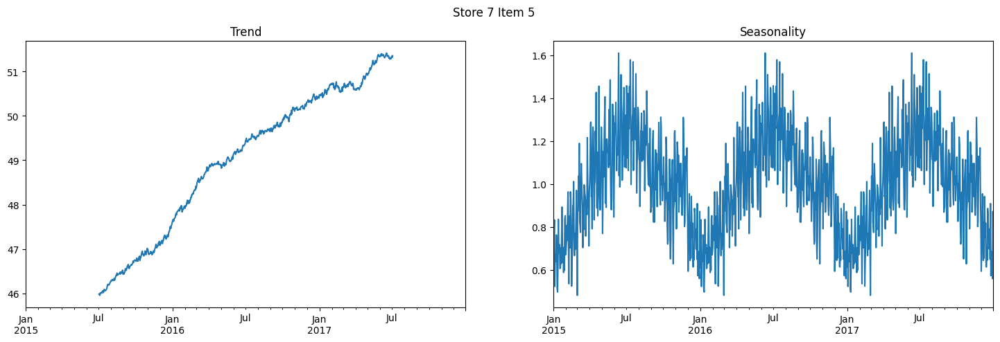

...

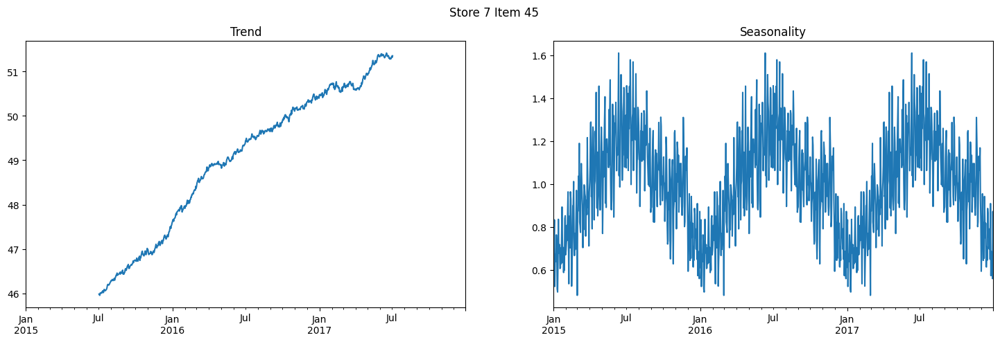

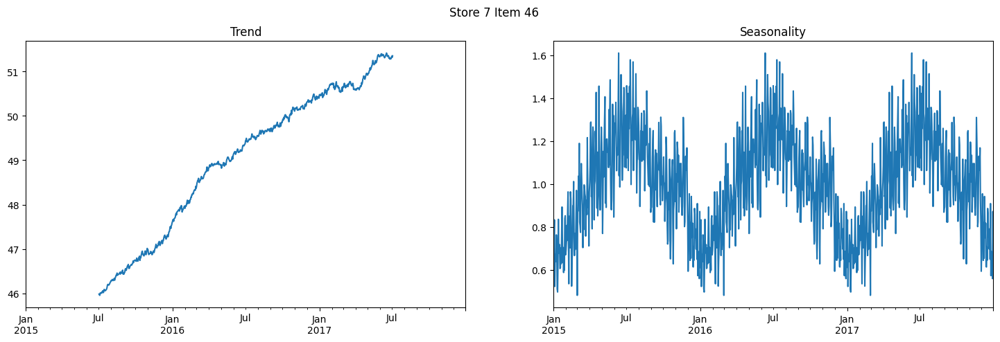

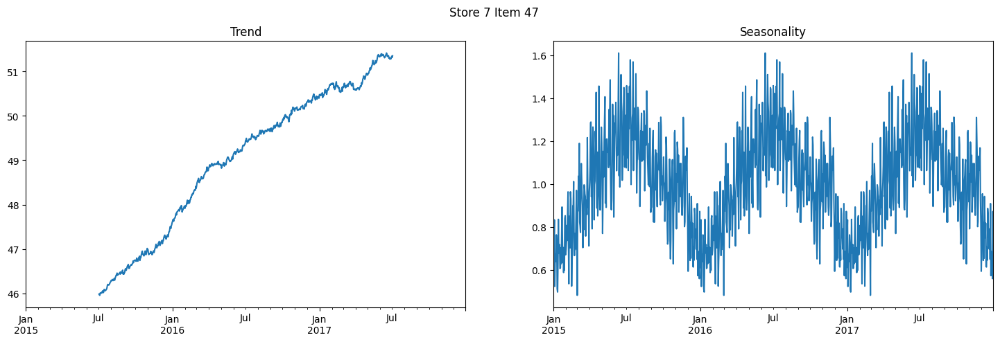

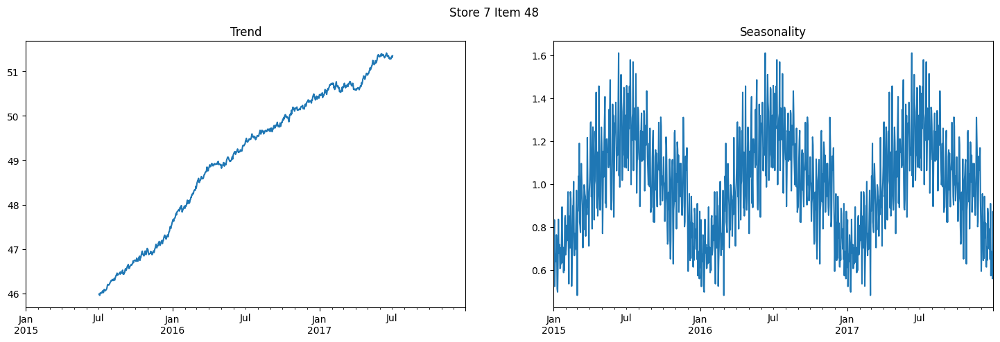

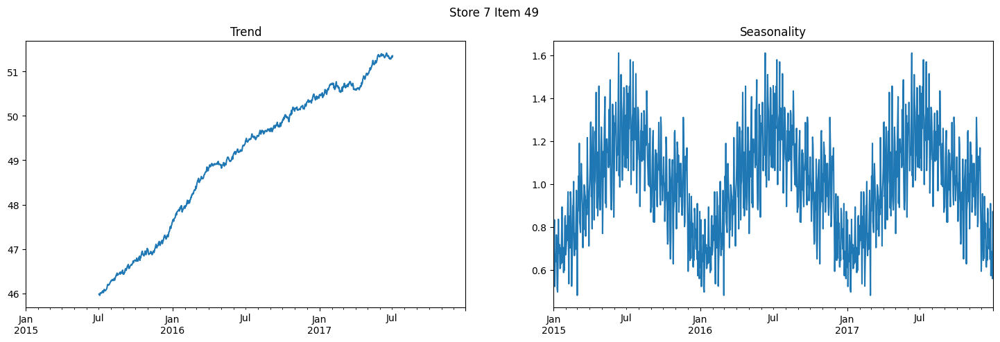

In [ ]:
# Trend and Seasonality of store with the lowest total sales
seasonal_dec(store=7, item=max(train["item"]))

Output()

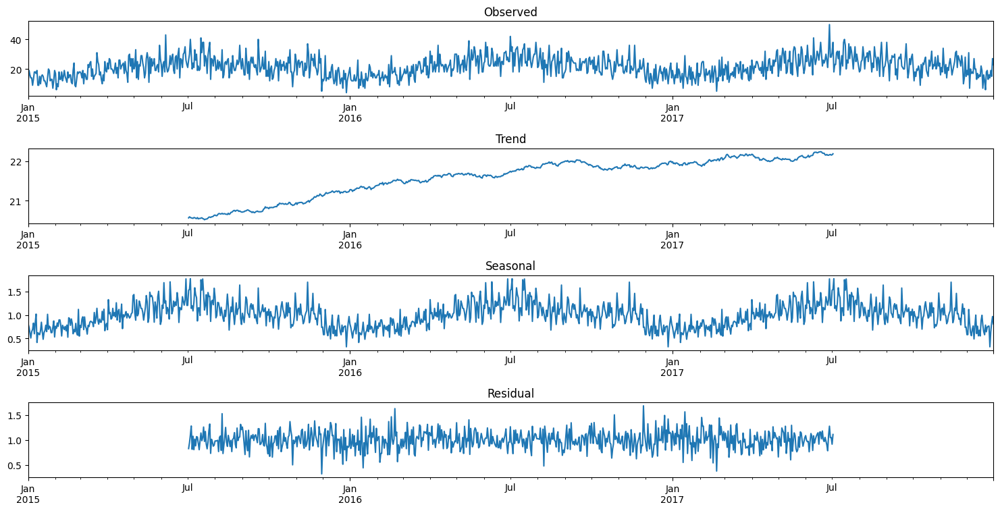

In [ ]:
# ETS Decomposition using bokeh
freq_season_mapping = {"None":None, "Weekly": 7, "Monthly":30, "Yearly":365}

def seasonal_dec_bokeh(i_num, s_num, seasonality="Yearly", ets_model="multiplicative"):
    df_se_decomp = train_copy.query("store == @s_num & item == @i_num").set_index("date")["sales"]
    freq = freq_season_mapping[seasonality]

    fig, axes = plt.subplots(4, 1, figsize=(15,8))
    decomp = seasonal_decompose(df_se_decomp, model=ets_model, period=freq)
    decomp.observed.plot(ax=axes[0], title="Observed")
    axes[0].set(xlabel="")
    decomp.trend.plot(ax=axes[1], title="Trend")
    axes[1].set(xlabel="")
    decomp.seasonal.plot(ax=axes[2], title="Seasonal")
    axes[2].set(xlabel="")
    decomp.resid.plot(ax=axes[3], title="Residual")
    axes[3].set(xlabel="")

    fig.tight_layout(rect=[0, 0, 1, 0.96])


s_slider = widgets.IntSlider(min=1, max=10, continuous_update=False, description="Store",
                             layout={"width": "2.8in", "height": "1in"})

i_slider = widgets.IntSlider(min=1, max=50, continuous_update=False, description="Item",
                             layout={"width": "2.8in", "height": "1in"})

seasonal_drop = widgets.Dropdown(value="Yearly", options=["Weekly", "Monthly", "Yearly"],
                               description="Seasonality", layout={"width": "2.1in"})

etsmodel_drop = widgets.Dropdown(value="multiplicative", options=["additive", "multiplicative"],
                                description="ETS model", layout={"width": "2.2in"})

ui = widgets.HBox([s_slider, i_slider, seasonal_drop, etsmodel_drop],
                  layout={"min_width": "1in", "max_width": "20in"})

out = widgets.interactive_output(seasonal_dec_bokeh, {"s_num": s_slider, "i_num": i_slider,
                                                        "seasonality": seasonal_drop, "ets_model": etsmodel_drop})
display(ui, out)

# Feature Engineering

1. Time Related Features
2. Lagged Features
3. Moving Average Features
4. Hypothesis Testing: Similarity Features
5. Exponentially Weighted Mean Features

In [ ]:
#val = train.query("date >= '2017-10-01'")
#train = train[(train["date"] >= "2015-01-01") & (train["date"] <= "2017-09-30")]
#df = pd.concat([train, val, test], sort=False)

# Sorting the data by store, item and date so we can apply shift methods
#train.sort_values(by=["store","item","date"], axis=0, inplace=True)
#val.sort_values(by=["store","item","date"], axis=0, inplace=True)
#test.sort_values(by=["store","item","date"], axis=0, inplace=True)
#df.sort_values(by=["store","item","date"], axis=0, inplace=True)


In [ ]:
train_copy_1_1 = train_copy.query("store ==1 & item ==1").set_index("date")
#train_copy_1_1.sort_values(by=['store','item','date'], axis=0, inplace=True)
train_copy_1_1.head()

,store,item,sales,Promo,SchoolHoliday,month
date,,,,,,
2015-01-01,1,1,11,0,0,1
2015-01-02,1,1,19,0,1,1
2015-01-03,1,1,16,0,1,1
2015-01-04,1,1,14,1,1,1
2015-01-05,1,1,14,1,1,1


In [ ]:
train_copy_1_1["ewm-12"] = train_copy_1_1["sales"].ewm(span=8).mean()

In [ ]:
train_copy_1_1.index.nunique()

1096

In [ ]:
lags = list(range(1, 730))

def create_lag_features(df, lag_list):
    for lag in lag_list:
        df['lag' + str(lag)] = df.groupby(["store", "item"]).sales.shift(lag)
    return df

In [ ]:
train_copy_1_1_lasso = create_lag_features(train_copy_1_1, lags)
train_copy_1_1_lasso = train_copy_1_1_lasso.dropna()

In [ ]:
features = [col for col in train_copy_1_1_lasso.columns if "lag" in col]
print("Number of Features: " + str(len(features)))

Number of Features: 729


In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV, RandomizedSearchCV
y = StandardScaler().fit_transform(train_copy_1_1_lasso.sales.to_frame())
X = StandardScaler().fit_transform(train_copy_1_1_lasso[features])

<Axes: >

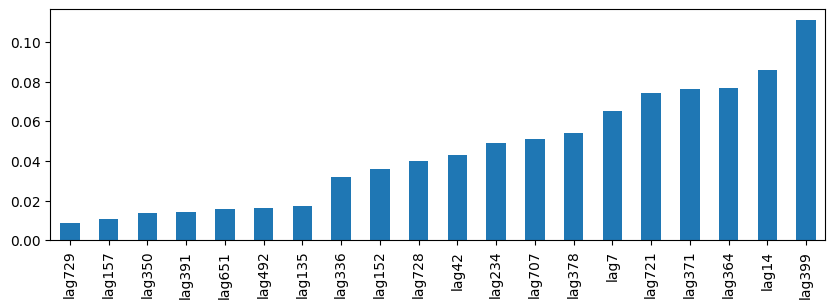

In [ ]:
from sklearn.linear_model import Lasso
model = Lasso(alpha = 0.1)
model.fit(X,y)
feature_importance = pd.Series(index = features, data = model.coef_)
feature_importance.abs().nlargest(20).iloc[::-1].plot(kind = "bar", figsize = (10,3))

Text(0, 0.5, 'Partial autocorrelation')

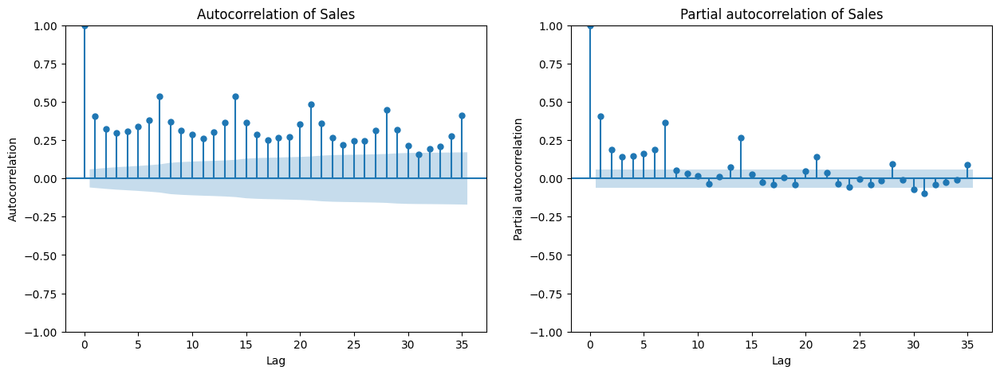

In [ ]:
fig, ax = plt.subplots(ncols=2, figsize=[15, 5])
plot_acf(train_copy_1_1.sales, lags=35, ax=ax[0])
ax[0].set_title("Autocorrelation of Sales")
ax[0].set_xlabel("Lag")
ax[0].set_ylabel("Autocorrelation")

plot_pacf(train_copy_1_1.sales, lags=35, ax=ax[1], method="ywmle")
ax[1].set_title("Partial autocorrelation of Sales")
ax[1].set_xlabel("Lag")
ax[1].set_ylabel("Partial autocorrelation")

In [ ]:
feature_importance.abs().nlargest(20).iloc[::-1]

lag729    0.008836
lag157    0.010577
lag350    0.013921
lag391    0.014502
lag651    0.015733
lag492    0.016310
lag135    0.017118
lag336    0.031832
lag152    0.035747
lag728    0.039929
lag42     0.042912
lag234    0.049254
lag707    0.051204
lag378    0.054183
lag7      0.065276
lag721    0.074422
lag371    0.076466
lag364    0.076592
lag14     0.086099
lag399    0.110863
dtype: float64

In [ ]:
lag = feature_importance[feature_importance>0].index

lags = []
for i in lag:
    l = i.removeprefix("lag")
    lags.append(int(l))

print(lags)

[7, 14, 42, 336, 350, 364, 371, 378, 391, 399, 644, 651, 707, 721, 728, 729]


## Time Related Features

In [ ]:
# Add holiday features
import holidays

def holiday_list(df):
  min_year = df.index.year.min()
  max_year = df.index.year.max()

  year_list = pd.period_range(min_year, max_year, freq="Y")
  list_of_holidays = []

  for year in year_list:
    list_of_holidays.append(holidays.US(years = int(str(year))).keys())

  holiday_list = [item for sublist in list_of_holidays for item in sublist]

  return holiday_list

def create_time_features(df):

    df['month'] = df.index.month
    df['day_of_month'] = df.index.day
    df['day_of_year'] = df.index.dayofyear
    df['week_of_year'] = df.index.isocalendar().week
    df['day_of_week'] = df.index.dayofweek + 1
    df['year'] = df.index.year
    df["is_wknd"] = df.index.weekday // 4
    df["quarter"] = df.index.quarter
    df['is_month_start'] = df.index.is_month_start.astype(int)
    df['is_month_end'] = df.index.is_month_end.astype(int)
    df['is_quarter_start'] = df.index.is_quarter_start.astype(int)
    df['is_quarter_end'] = df.index.is_quarter_end.astype(int)
    df['is_year_start'] = df.index.is_year_start.astype(int)
    df['is_year_end'] = df.index.is_year_end.astype(int)
    df['is_holiday'] = np.where(df.index.isin(holiday_list(df)),1,0).astype(int)

    # 0: Winter - 1: Spring - 2: Summer - 3: Fall
    df["season"] = np.where(df.month.isin([12,1,2]), 0, 1)
    df["season"] = np.where(df.month.isin([6,7,8]), 2, df["season"])
    df["season"] = np.where(df.month.isin([9, 10, 11]), 3, df["season"])
    return df

## Lagged Features

In [ ]:
def create_lagged_features(df, lags):
    for lag in lags:
        df[f'sales_lag_{lag}'] = df.groupby(['store', 'item'])['sales'].shift(lag)
    return df

## Moving Average Features

In [ ]:
def create_rolling_features(df, windows):
    for window in windows:
        df[f'rolling_mean_{window}'] = df.groupby(['store', 'item'])['sales'].transform(lambda x: x.rolling(window=window).mean())
        df[f'rolling_std_{window}'] = df.groupby(['store', 'item'])['sales'].transform(lambda x: x.rolling(window=window).std())
    return df

## Exponentially Weighted Mean Features

In [ ]:
def create_ewm_features(df, span):
    # EWM features
    for i in span:
        df[f'ewm_{i}'] = df.groupby(['store', 'item'])['sales'].transform(lambda x: x.ewm(span=i).mean())
    return df

In [ ]:
# Add Fourier series terms for seasonality
def add_fourier_terms(df, periods, max_k):
    for period in periods:
        for k in range(1, max_k + 1):
            df[f'sin_{period}_{k}'] = np.sin(2 * np.pi * k * df['day_of_year'] / period)
            df[f'cos_{period}_{k}'] = np.cos(2 * np.pi * k * df['day_of_year'] / period)
    return df

## Decomposing Time Series Data

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

def decompose_sales_data(df, model='additive', freq=365):
    results = {}
    for (store, item), group in df.groupby(['store', 'item']):
        decomp = seasonal_decompose(group['sales'], model=model, period=freq)
        results[(store, item)] = decomp
    return results

In [ ]:
# Create time-based features
train = train.set_index("date")
train = create_time_features(train)
#test = create_time_features(test)

# Create lagged features
#lags = [7, 14, 21, 28, 35, 42]
train = create_lagged_features(train, lags)

# Create rolling features
#window_sizes = [7, 14, 21, 28, 35, 42]
window_sizes = lags
train = create_rolling_features(train, lags)

# Create exponentially weighted mean features
#span = [28, 42, 56]
span = lags
train = create_ewm_features(train, span)

# Yearly, weekly, and quarterly seasonality
train = add_fourier_terms(train, [365.25, 52.25, 91.25], 3)

# Decompose sales data (optional, for analysis and understanding)
decomp_results = decompose_sales_data(train, model='additive', freq=365)

In [ ]:
print(train.shape)
print(test.shape)

(548000, 103)
(45000, 6)


In [ ]:
#train.dropna(inplace=True)
train.dropna().shape

(183500, 103)

# Model

## Initial Model

In [ ]:
print("Earliest date in dataset: " + str(min(train.index))[0:10])
print("Latest date in dataset: " + str(max(train.index))[0:10])
print("")

Earliest date in dataset: 2015-01-01
Latest date in dataset: 2017-12-31



In [ ]:
X = train.drop(columns=['sales'])
Y = train["sales"]

In [ ]:
X_train = X.loc[X.index < '2017-10-01']
y_train = Y.loc[Y.index < '2017-10-01']

val_mask = (X.index >= "2017-10-01") & (X.index  <= "2017-12-31")

X_val = X.loc[val_mask]
y_val = Y.loc[val_mask]

print(X_train.shape, y_train.shape, X_val.shape, y_val.shape)

(502000, 102) (502000,) (46000, 102) (46000,)


In [ ]:
def smape_metric(y_true, y_pred):
    smape = 100/len(y_pred) * np.sum(2*np.abs(y_pred - y_true) / (np.abs(y_true) + np.abs(y_pred)))
    return round(smape,2)

def wape_metric(y_true, y_pred):
    denominator = y_true.sum()
    if denominator == 0:
        return 0  # or handle as appropriate, perhaps return NaN
    else:
        wape_score = round((np.sum(np.abs(y_true - y_pred)) / np.sum(y_true))*100,2)
    return wape_score

def lightgbm_metric(y_true, y_pred):
    smape_val = smape_metric(y_true, y_pred)
    wape_val = wape_metric(y_true, y_pred)
    return 'SMAPE', smape_val, False, 'WAPE', wape_val, False

def cross_validate(e, X, y):
    from sklearn.model_selection import cross_val_score
    accuracy = cross_val_score(estimator=e, X= X, y= y, cv= 10)
    return accuracy.mean()*100

In [ ]:
from sklearn.model_selection import cross_val_score

In [ ]:
## Brute Force

In [ ]:
def initial_model(X_train, y_train):
    lgb_model = lgb.LGBMRegressor().fit(X_train, y_train, eval_metric =
                                        lambda y_true, y_pred: [lightgbm_metric(y_true, y_pred)])
    return lgb_model

In [ ]:
base_model = initial_model(X_train, y_train)

def predictions(model, X):
    return model.predict(X)

y_pred_t = predictions(base_model, X_train)
y_pred = predictions(base_model, X_val)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.053945 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20038
[LightGBM] [Info] Number of data points in the train set: 502000, number of used features: 102
[LightGBM] [Info] Start training from score 56.001235


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')
/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


In [ ]:
print("\n############################## SMAPE ##############################")
print("Training SMAPE: {}%".format(smape_metric(y_train, y_pred_t)))
print("Validation SMAPE: {}%".format(smape_metric(y_val, y_pred)))

print("\n############################## WAPE ##############################")
print("Training WAPE: {}%".format(wape_metric(y_train, y_pred_t)))
print("Validation WAPE: {}%".format(wape_metric(y_val, y_pred)))

from sklearn.metrics import r2_score
print("\n############################## R2 score ##############################")
print("Training R2 score: {}".format(round(r2_score(y_train, y_pred_t),2)))
print("Validation R2 score: {}".format(round(r2_score(y_val, y_pred),2)))

#print("\n############################## 10-fold Cross Validation ##############################")
#print("Training 10-fold Cross Validation accuracy: {:.2f}%\n".
#      format(cross_validate(lgb_model, X_train, y_train)))
#print("Validation 10-fold Cross Validation accuracy: {:.2f}%\n".
#      format(cross_validate(lgb_model, X_val, y_val)))


############################## SMAPE ##############################
Training SMAPE: 8.19%
Validation SMAPE: 8.38%

############################## WAPE ##############################
Training WAPE: 6.86%
Validation WAPE: 7.12%

############################## R2 score ##############################
Training R2 score: 0.97
Validation R2 score: 0.97


In [ ]:
## Pipeline

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# Define the model
lgb_regressor = lgb.LGBMRegressor()

# Create the pipeline
pipeline = Pipeline([
    #('scaler', StandardScaler()),  # Uncomment if scaling is needed
    ('regressor', lgb_regressor)
])

# fit call
# pipeline.fit(X_train, y_train)

In [ ]:
try:
    pipeline.fit(X_train, y_train)
except Exception as e:
    print("An error occurred:", e)

In [ ]:
from sklearn.metrics import mean_squared_error

# Making predictions
y_train_pred = pipeline.predict(X_train)
y_val_pred = pipeline.predict(X_val)

# Evaluate the model
train_smape = smape(y_train, y_train_pred)
val_smape = smape(y_val, y_val_pred)

print("Training SMAPE:", train_smape)
print("Validation SMAPE:", val_smape)

In [ ]:
train.columns

Index(['store', 'item', 'sales', 'Promo', 'SchoolHoliday', 'month',
       'day_of_month', 'day_of_year', 'week_of_year', 'day_of_week',
       ...
       'sin_52.25_2', 'cos_52.25_2', 'sin_52.25_3', 'cos_52.25_3',
       'sin_91.25_1', 'cos_91.25_1', 'sin_91.25_2', 'cos_91.25_2',
       'sin_91.25_3', 'cos_91.25_3'],
      dtype='object', length=103)

## Feature Importance

In [ ]:
def generate_feature_importance_df(model):
  gain = model.booster_.feature_importance(importance_type ="gain")
  feature_importance_df = pd.DataFrame({
      "feature": model.feature_name_,
      "split": model.booster_.feature_importance(importance_type="split"),
      "gain": 100*gain/ gain.sum()
  }).sort_values("gain", ascending=False)

  return feature_importance_df

feature_importance_df = generate_feature_importance_df(base_model)
feature_importance_df

,feature,split,gain
68,ewm_7,1063,94.094275
8,day_of_week,459,4.766343
38,rolling_mean_14,290,0.352496
37,rolling_std_7,338,0.350173
36,rolling_mean_7,574,0.260398
...,...,...,...
97,cos_91.25_1,0,0.000000
98,sin_91.25_2,0,0.000000
99,cos_91.25_2,0,0.000000
100,sin_91.25_3,0,0.000000


In [ ]:
important_features = feature_importance_df[["feature","gain"]].query("gain >0.00")["feature"].values.tolist()

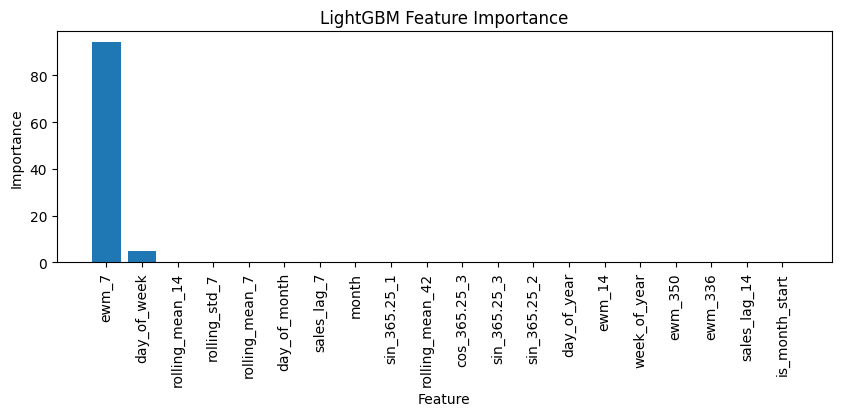

In [ ]:
fig = plt.figure(figsize = (10,3))
plt.bar(feature_importance_df.feature[:20], feature_importance_df.gain[:20])
plt.xticks(rotation = 'vertical')
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('LightGBM Feature Importance')
plt.show()

In [ ]:
# Hyperparameter tuning
param_grid = {
    'num_leaves': [31, 63],
    'max_depth': [10, 20],
    'learning_rate': [0.1, 0.01],
    'n_estimators': [500, 1000]
}
random_search = RandomizedSearchCV(lgb.LGBMRegressor(), param_grid, cv=3, scoring='neg_mean_absolute_percentage_error')
random_search.fit(X_train, y_train)
best_params = random_search.best_params_
best_model = random_search.best_estimator_

# Evaluate best model
y_pred_best = best_model.predict(X_val)
wape_best = wape_metric(y_val, y_pred_best)
improved_wape_score = wape_best

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035633 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.047778 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furthe

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.051705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.177220 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.034431 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.033690 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.149716 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.175585 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.033889 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035992 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035820 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.036399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.034040 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.194181 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.203219 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.033107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.047613 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035500 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.033366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.033241 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032969 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032616 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032807 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20017
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 102
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.033396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20002
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.189296 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20076
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 102
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.049962 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20038
[LightGBM] [Info] Number of data points in the train set: 502000, number of used features: 102
[LightGBM] [Info] Start training from score 56.001235
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


In [ ]:
# Second hyperparameter tuning (important features only)
X_train_important = X_train[important_features]
X_val_important = X_val[important_features]

random_search_important = RandomizedSearchCV(lgb.LGBMRegressor(), param_grid, cv=3, scoring='neg_mean_absolute_percentage_error')
random_search_important.fit(X_train_important, y_train)
best_params_important_features = random_search_important.best_params_
best_model_important_features = random_search_important.best_estimator_

# Evaluate best model with important features
y_pred_best_important_features = best_model_important_features.predict(X_val_important)
wape_best_important_features = wape_metric(y_val, y_pred_best_important_features)


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007955 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007938 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009215 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007746 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008009 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012561 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.035457 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007947 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007857 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007860 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008030 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007775 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007852 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.037567 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007650 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009537 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007771 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007434 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007473 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008029 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 334666, number of used features: 29
[LightGBM] [Info] Start training from score 55.282766


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5559
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 54.096589


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5582
[LightGBM] [Info] Number of data points in the train set: 334667, number of used features: 29
[LightGBM] [Info] Start training from score 58.624349


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011525 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5563
[LightGBM] [Info] Number of data points in the train set: 502000, number of used features: 29
[LightGBM] [Info] Start training from score 56.001235
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


In [ ]:
# Feature importance for improved model with important features
base_wape_score = wape_metric(y_val, base_model.predict(X_val))
feature_importance_df_important_features = generate_feature_importance_df(best_model_important_features)
print("Feature importances for the improved model (important features):\n", feature_importance_df_important_features)

print("\nBase WAPE Score: {}%\nImproved WAPE Score(all features): {}%\nImproved WAPE Score(important features): {}%"\
      .format(round(base_wape_score,2), round(improved_wape_score,2), round(wape_best_important_features,2)))

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


Feature importances for the improved model (important features):
             feature  split       gain
0             ewm_7   9542  93.374180
1       day_of_week   3154   4.681228
4    rolling_mean_7   7295   0.552064
2   rolling_mean_14   3058   0.491631
3     rolling_std_7   5267   0.410814
14           ewm_14   2976   0.081941
6       sales_lag_7   3621   0.058188
5      day_of_month   1800   0.042103
25    sales_lag_371   3509   0.032757
18     sales_lag_14   3219   0.029678
21   rolling_std_14   3246   0.029357
11     sin_365.25_3   1287   0.028965
10     cos_365.25_3   1456   0.026839
8      sin_365.25_1   1178   0.024976
9   rolling_mean_42   1553   0.017672
26    sales_lag_721   1803   0.016866
28    sales_lag_728   1715   0.016152
7             month     99   0.015305
12     sin_365.25_2   1204   0.014756
16          ewm_350   1033   0.011157
22           ewm_42   1068   0.010614
15     week_of_year    187   0.007090
23     cos_365.25_2    682   0.006127
17          ewm_336   

In [ ]:
final_param_d = {}
final_param_d["base_wape_score"] = base_wape_score
final_param_d["improved_wape_score"] = improved_wape_score
final_param_d["wape_best_important_features"] = wape_best_important_features

final_param = list(final_param_d.keys())[list(final_param_d.values()).index(min(final_param_d.values()))]

if final_param == "improved_wape_score":
  final_model_param = best_params
elif final_param == "wape_best_important_features":
  final_model_param = best_params_important_features
else:
  final_model = base_model

In [ ]:
final_model_param

{'num_leaves': 63, 'n_estimators': 1000, 'max_depth': 20, 'learning_rate': 0.1}

In [ ]:
test = test.set_index("date")
train['is_future'] = False
test['is_future'] = True
final_df = pd.concat([train, test])

final_df = create_time_features(final_df)
final_df = create_lagged_features(final_df, lags)
final_df = create_rolling_features(final_df, window_sizes)
final_df = create_ewm_features(final_df, span)
final_df = add_fourier_terms(final_df, [365.25, 52.25, 91.25], 3)

future = final_df.query("is_future == True").copy()

In [ ]:
final_df.shape

(593000, 105)

In [ ]:
final_model_param

{'num_leaves': 63, 'n_estimators': 1000, 'max_depth': 20, 'learning_rate': 0.1}

In [ ]:
final_model_param.values()

dict_values([63, 1000, 20, 0.1])

In [ ]:
final_model = lgb.LGBMRegressor(learning_rate= 0.1, max_depth= 20,
                            n_estimators= 1000, num_leaves= 63).\
                            fit(X_train, y_train,
                                eval_metric =lambda y_true, y_pred: [lightgbm_metric(y_true, y_pred)])

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.058300 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20038
[LightGBM] [Info] Number of data points in the train set: 502000, number of used features: 102
[LightGBM] [Info] Start training from score 56.001235
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


In [ ]:
y_pred_t = predictions(final_model, X_train)
y_pred = predictions(final_model, X_val)

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')
/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


In [ ]:
print("\n############################## SMAPE ##############################")
print("Training SMAPE: {}%".format(smape_metric(y_train, y_pred_t)))
print("Validation SMAPE: {}%".format(smape_metric(y_val, y_pred)))

print("\n############################## WAPE ##############################")
print("Training WAPE: {}%".format(wape_metric(y_train, y_pred_t)))
print("Validation WAPE: {}%".format(wape_metric(y_val, y_pred)))

from sklearn.metrics import r2_score
print("\n############################## R2 score ##############################")
print("Training R2 score: {}".format(round(r2_score(y_train, y_pred_t),2)))
print("Validation R2 score: {}".format(round(r2_score(y_val, y_pred),2)))

#print("\n############################## 10-fold Cross Validation ##############################")
#print("Training 10-fold Cross Validation accuracy: {:.2f}%\n".
#      format(cross_validate(lgb_model, X_train, y_train)))
#print("Validation 10-fold Cross Validation accuracy: {:.2f}%\n".
#      format(cross_validate(lgb_model, X_val, y_val)))


############################## SMAPE ##############################
Training SMAPE: 6.61%
Validation SMAPE: 7.26%

############################## WAPE ##############################
Training WAPE: 5.39%
Validation WAPE: 6.22%

############################## R2 score ##############################
Training R2 score: 0.98
Validation R2 score: 0.98


In [ ]:
future['Pred']= final_model.predict(future[X_val.columns])
future_copy = future[['store', 'item', 'Pred']].copy()
future_copy = future_copy.rename(columns={"Pred":"sales"})

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


In [ ]:
future_copy.head()

,store,item,sales
date,,,
2018-01-01,1,1,17.089673
2018-01-02,1,1,21.521865
2018-01-03,1,1,22.941314
2018-01-04,1,1,22.831115
2018-01-05,1,1,23.897107


In [ ]:
train_copy_2 = train[['store', 'item', 'sales']].copy()
future_copy = future_copy[['store', 'item', 'sales']]
new_df = pd.concat([train_copy_2, future_copy])

In [ ]:
new_df.tail()

,store,item,sales
date,,,
2018-03-27,10,50,64.812120
2018-03-28,10,50,67.030452
2018-03-29,10,50,68.635775
2018-03-30,10,50,69.999275
2018-03-31,10,50,70.935424


In [ ]:
new_df.head()

,store,item,sales
date,,,
2015-01-01,1,1,11.0
2015-01-02,1,1,19.0
2015-01-03,1,1,16.0
2015-01-04,1,1,14.0
2015-01-05,1,1,14.0


/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


Text(0.5, 1.0, 'LightGBM Final Prediction')

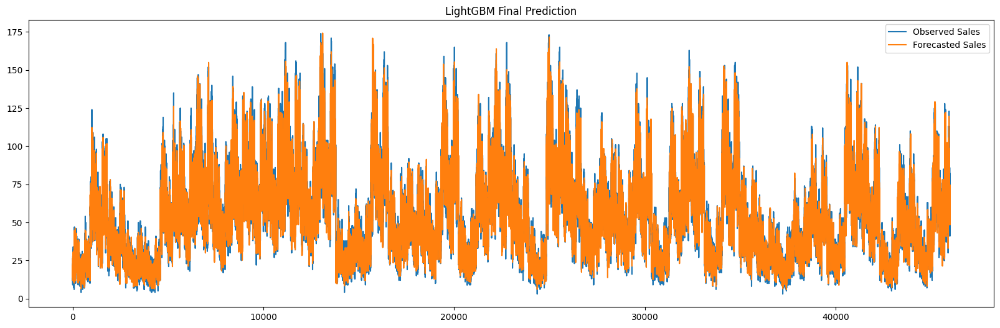

In [ ]:
fig = plt.figure(figsize = (20,6))
sales = plt.plot(y_val.values, label = 'Observed Sales')
forecast = plt.plot(final_model.predict(X_val), label = 'Forecasted Sales')
plt.legend(loc = 'best')
plt.title("LightGBM Final Prediction")


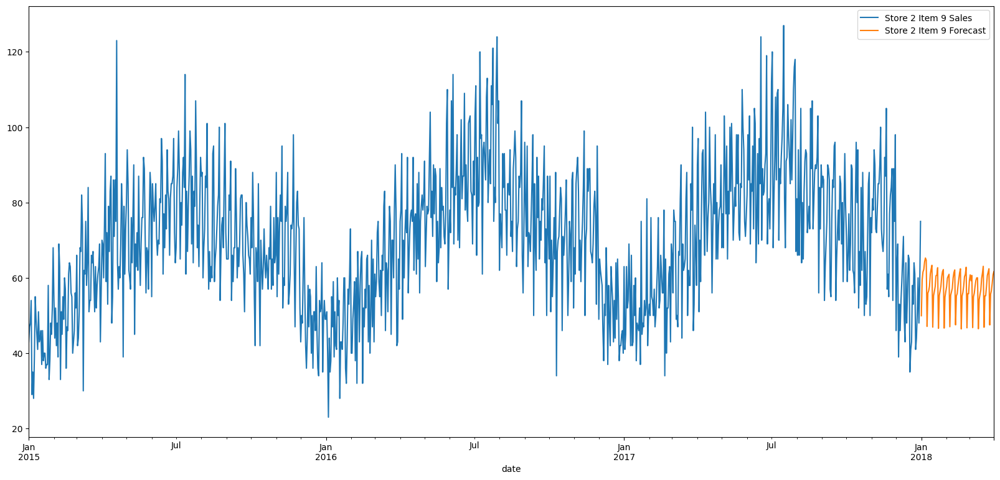

In [ ]:
train_copy_2[(train_copy_2.store == 2) & (train_copy_2.item == 9)].sales.plot(figsize = (20,9),legend=True, label = "Store 2 Item 9 Sales")
future_copy[(future_copy.store == 2) & (future_copy.item == 9)].sales.plot(legend=True, label = "Store 2 Item 9 Forecast");

In [ ]:
error = pd.DataFrame({
    "date":X_val.index,
    "store":X_val.store,
    "item":X_val.item,
    "actual":y_val,
    "pred_base":base_model.predict(X_val),
    "pred_final":final_model.predict(X_val)
}).reset_index(drop = True)

error = error.set_index("date")
error.head()
error["error_base"] = np.abs(error.actual-error.pred_base)
error["error_final"] = np.abs(error.actual-error.pred_final)

error["error_percetange_base"] =round((error["error_base"] / error["actual"]) * 100,2)
error["error_percetange_final"] =round((error["error_final"] / error["actual"]) * 100,2)

error.sort_values("error_percetange_final", ascending=False).head(20)

/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')
/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py:1073: UserWarning: Converting data to scipy sparse matrix.
  _log_warning('Converting data to scipy sparse matrix.')


,store,item,actual,pred_base,pred_final,error_base,error_final,error_percetange_base,error_percetange_final
date,,,,,,,,,
2017-12-29,7,5,4,11.070301,10.280956,7.070301,6.280956,176.76,157.02
2017-10-06,6,5,9,16.227376,20.128801,7.227376,11.128801,80.30,123.65
2017-12-07,2,34,12,27.835724,26.588450,15.835724,14.588450,131.96,121.57
2017-12-21,7,49,7,15.796912,15.211500,8.796912,8.211500,125.67,117.31
2017-12-04,5,41,3,9.088597,6.495428,6.088597,3.495428,202.95,116.51
2017-12-25,5,16,4,11.036537,8.482139,7.036537,4.482139,175.91,112.05
2017-12-06,7,47,5,11.561909,10.557698,6.561909,5.557698,131.24,111.15
2017-12-30,6,5,5,11.535770,10.546950,6.535770,5.546950,130.72,110.94
2017-12-10,7,41,5,11.917199,10.203996,6.917199,5.203996,138.34,104.08


In [ ]:
error.sort_values("error_percetange_final", ascending=True).head(20)

,store,item,actual,pred_base,pred_final,error_base,error_final,error_percetange_base,error_percetange_final
date,,,,,,,,,
2017-11-18,2,9,87,88.049941,87.002217,1.049941,0.002217,1.21,0.00
2017-10-30,1,10,59,59.421425,59.001710,0.421425,0.001710,0.71,0.00
2017-11-17,6,10,69,69.243790,69.002015,0.243790,0.002015,0.35,0.00
2017-11-03,4,17,37,39.844187,36.998889,2.844187,0.001111,7.69,0.00
2017-12-29,9,22,91,84.470949,90.997272,6.529051,0.002728,7.17,0.00
2017-11-20,10,25,82,85.292480,81.997889,3.292480,0.002111,4.02,0.00
2017-11-24,6,31,58,55.741533,57.997301,2.258467,0.002699,3.89,0.00
2017-11-25,6,33,75,73.551065,75.001397,1.448935,0.001397,1.93,0.00
2017-10-18,8,34,31,30.289249,31.001100,0.710751,0.001100,2.29,0.00


In [104]:
correct_15 = error[["error_percetange_final"]].query("error_percetange_final <= 15").count()
correct_15

error_percetange_final    41086
dtype: int64

In [105]:
print("Predictions with <=15% margin of error: {}%".format(round(list(correct_15)[0] / len(error) * 100 ,2)))

Predictions with <=15% margin of error: 89.32%


In [106]:
correct_10 = error[["error_percetange_final"]].query("error_percetange_final <= 10").count()
correct_10

error_percetange_final    34605
dtype: int64

In [108]:
print("Predictions with <=10% margin of error: {}%".format(round(list(correct_10)[0] / len(error) * 100 ,2)))

Predictions with <=10% margin of error: 75.23%
